#  Weapon YOLOv12 Train and Predict

In [1]:
#!rm -rf 

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 921.5/921.5 kB 18.1 MB/s eta 0:00:00


In [3]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics 8.3.78 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.0/8062.4 GB disk)


In [4]:
train_path='//kaggle/input/weapon-annotation-data-modified/data/train/'
valid_path='/kaggle/input/weapon-annotation-data-modified/data/val/'

In [5]:
Name=['Automatic Rifle', 'Bazooka', 'Handgun', 'Knife', 'Grenade Launcher', 'Shotgun', 'SMG', 'Sniper', 'Sword' ]
N=list(range(9))
normal_mapping=dict(zip(Name,N)) 
reverse_mapping=dict(zip(N,Name))  

# Create yaml file 

In [6]:
import yaml

data_yaml = dict(
    train = train_path,
    val = valid_path,
    nc = 9,
    names = Name
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)
    
%cat data.yaml

{names: [Automatic Rifle, Bazooka, Handgun, Knife, Grenade Launcher, Shotgun, SMG,
    Sniper, Sword], nc: 9, train: //kaggle/input/weapon-annotation-data-modified/data/train/,
  val: /kaggle/input/weapon-annotation-data-modified/data/val/}


# Train

In [7]:
model = YOLO("yolo12x.pt") 

100%|██████████| 114M/114M [00:00<00:00, 221MB/s]


In [8]:
!yolo task=detect mode=train model=yolo12x.pt data=data.yaml epochs=40 imgsz=480

Ultralytics 8.3.78 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12x.pt, data=data.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width

# Result of Training

In [9]:
paths2=[]
for dirname, _, filenames in os.walk('/kaggle/working/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpeg':
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)
print(len(paths2))
print(paths2[0:3])

7
['/kaggle/working/runs/detect/train/F1_curve.png', '/kaggle/working/runs/detect/train/PR_curve.png', '/kaggle/working/runs/detect/train/P_curve.png']


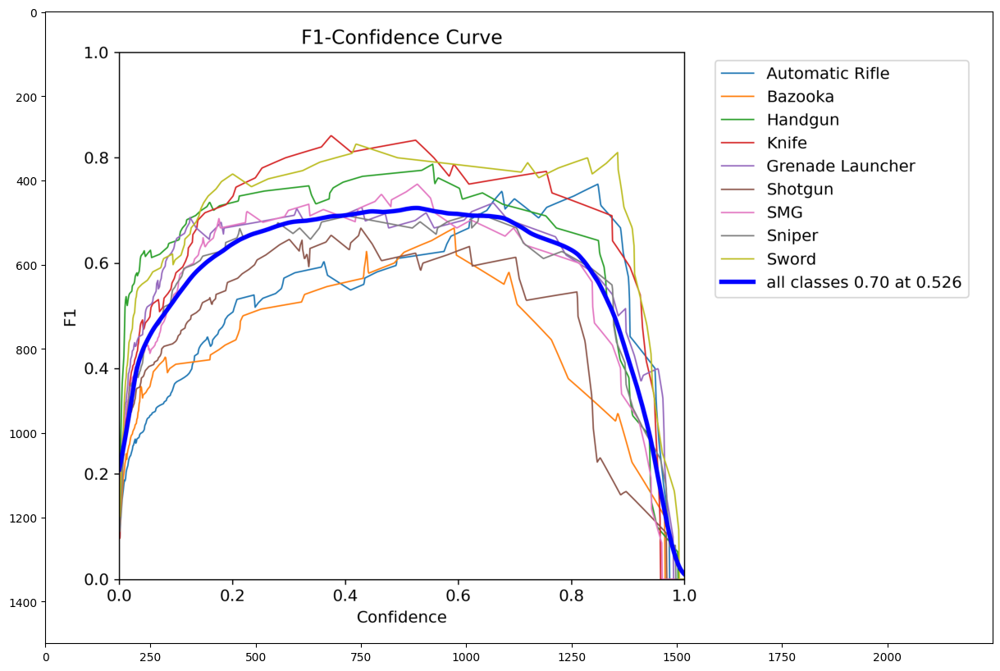

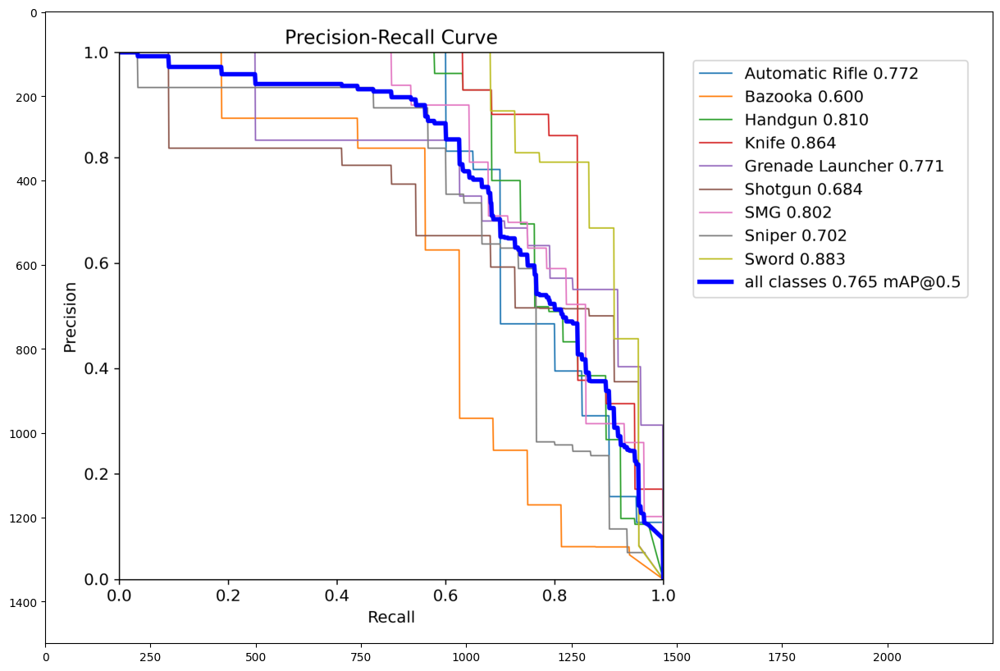

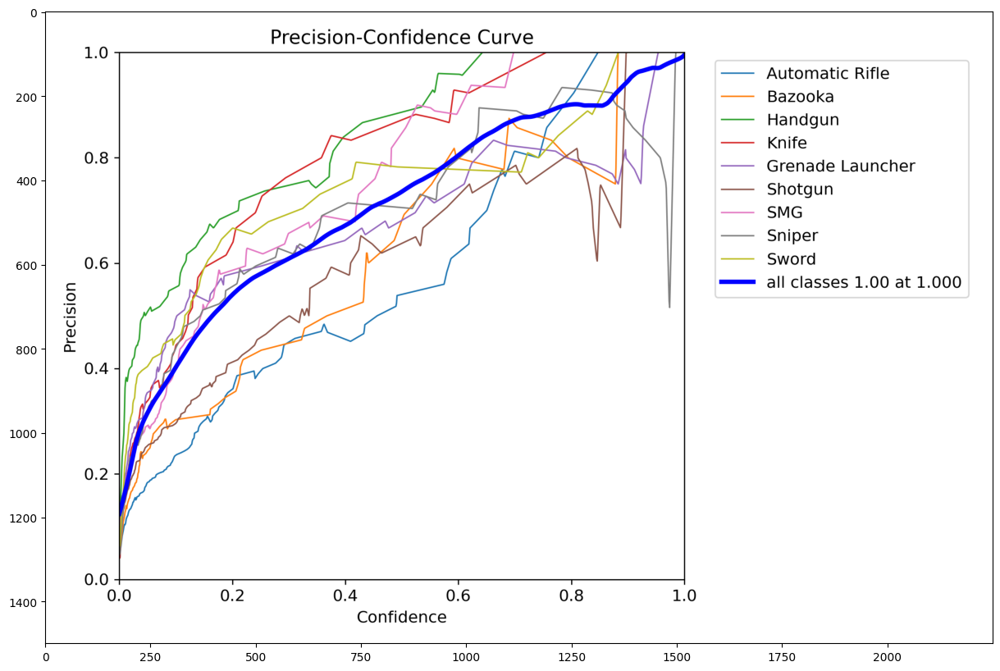

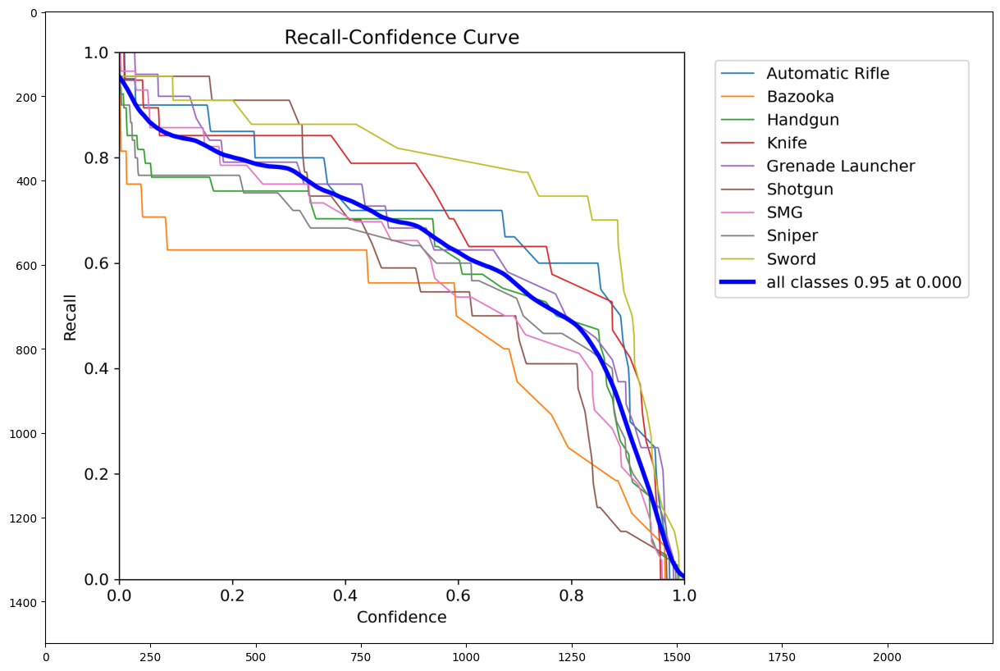

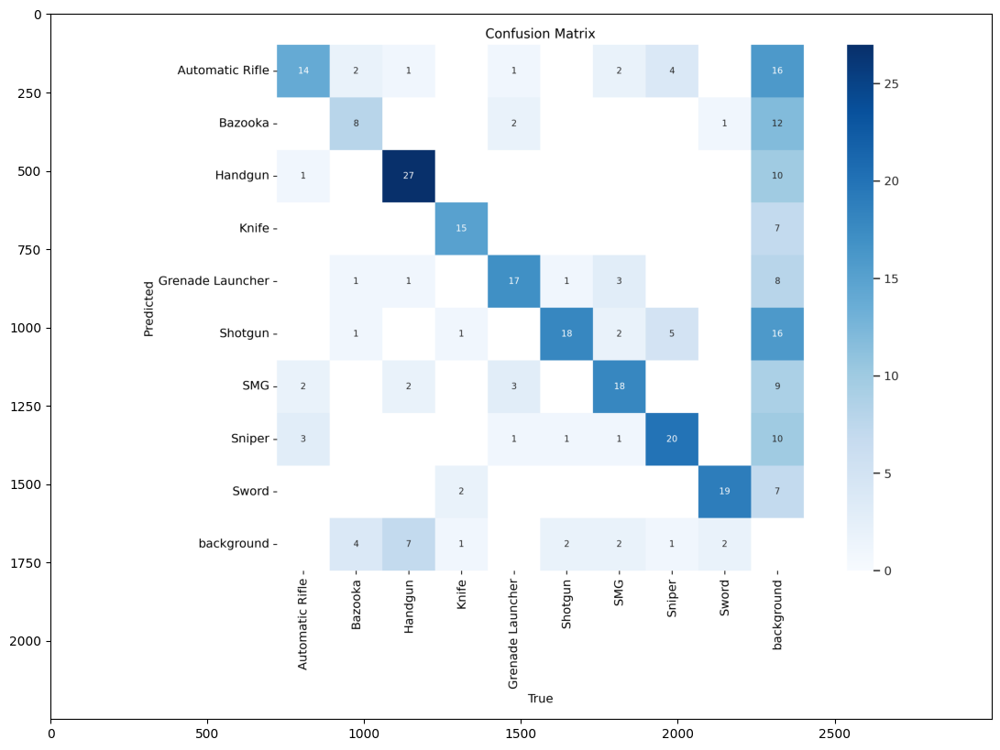

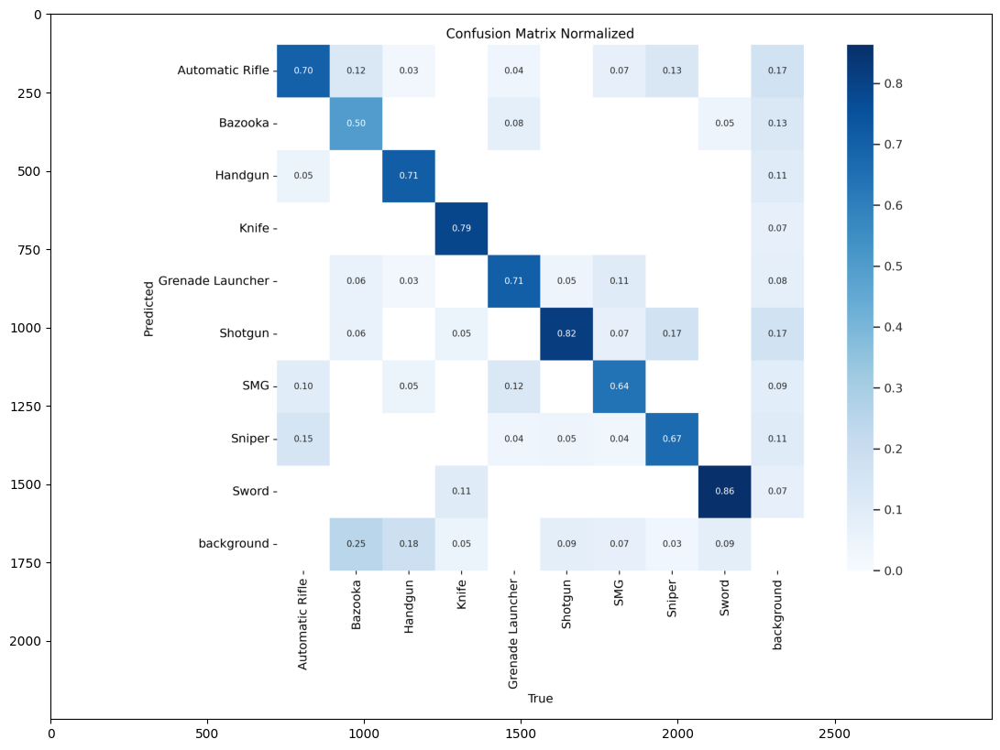

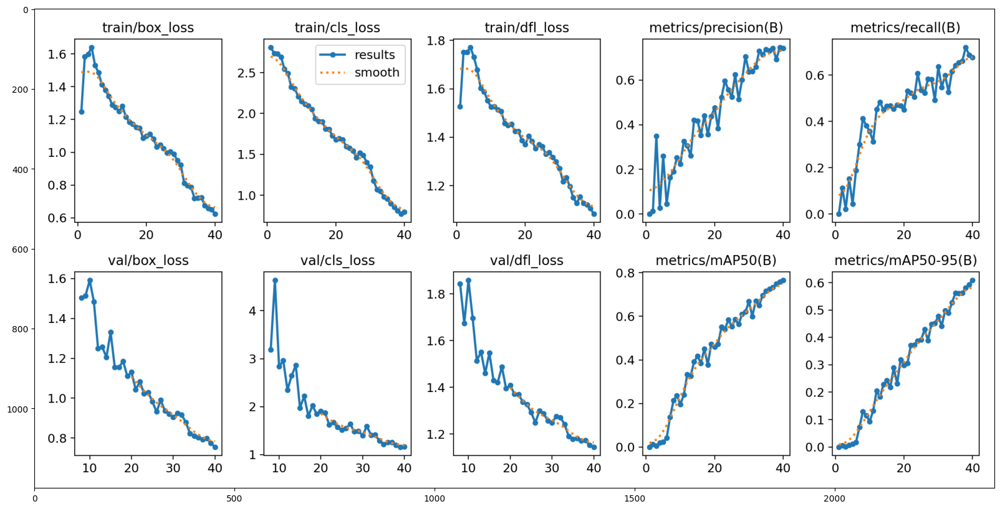

In [10]:
for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [11]:
best_path0='runs/detect/train/weights/best.pt'
source0=os.path.join(valid_path,'images')

In [12]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(len(ppaths))

143


In [13]:
model2 = YOLO(best_path0)

In [14]:
!yolo task=detect mode=predict model={best_path0} conf=0.6 source={source0}

Ultralytics 8.3.78 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12x summary (fused): 283 layers, 59,053,739 parameters, 0 gradients, 198.6 GFLOPs

image 1/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_13.jpeg: 256x480 1 Automatic Rifle, 88.8ms
image 2/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_19.jpeg: 288x480 1 Automatic Rifle, 68.5ms
image 3/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_28.png: 384x480 (no detections), 65.6ms
image 4/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_35.jpeg: 288x480 1 Sniper, 46.2ms
image 5/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_40.jpeg: 384x480 1 Automatic Rifle, 44.2ms
image 6/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_41.png: 160x480 1 Automatic Rifle, 64.3ms
image 7/143 /kaggle/input/weapon-annotation-d

# Result of Prediction

In [15]:
results = model2.predict(source0,conf=0.6)


image 1/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_13.jpeg: 256x480 1 Automatic Rifle, 69.3ms
image 2/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_19.jpeg: 288x480 1 Automatic Rifle, 67.8ms
image 3/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_28.png: 384x480 (no detections), 64.7ms
image 4/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_35.jpeg: 288x480 1 Sniper, 49.2ms
image 5/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_40.jpeg: 384x480 1 Automatic Rifle, 52.6ms
image 6/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_41.png: 160x480 1 Automatic Rifle, 66.5ms
image 7/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automatic Rifle_42.jpeg: 320x480 1 Shotgun, 1 SMG, 67.4ms
image 8/143 /kaggle/input/weapon-annotation-data-modified/data/val/images/Automati

In [16]:
print(len(results))
print(len(ppaths))

143
143


In [17]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

<ipython-input-17-ff91e98f23ee>:8: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  PBOX=pd.concat([PBOX,arri],axis=0)


,x,y,x2,y2,confidence,class,file,i
0,37.237225,40.250626,504.587006,219.419647,0.881968,0.0,Automatic Rifle_13.jpeg,0.0
0,1.281452,55.353226,747.672852,376.515533,0.898153,0.0,Automatic Rifle_19.jpeg,1.0
0,182.491333,241.125885,1721.880371,852.840210,0.961506,7.0,Automatic Rifle_35.jpeg,3.0
0,35.802082,156.142365,981.211304,479.366394,0.833136,0.0,Automatic Rifle_40.jpeg,4.0
0,85.059967,9.054604,1114.311035,357.562286,0.929952,0.0,Automatic Rifle_41.png,5.0
...,...,...,...,...,...,...,...,...
0,1322.039551,712.398010,1491.773682,1480.775635,0.960365,8.0,Sword_89.jpeg,139.0
1,54.916573,31.554604,1357.319458,1431.089600,0.930570,8.0,Sword_89.jpeg,139.0
0,129.565750,13.052264,1151.410034,845.142212,0.941615,8.0,Sword_9.jpeg,140.0
0,434.446106,191.284988,676.840271,1385.452271,0.873466,8.0,Sword_96.jpeg,141.0


In [18]:
PBOX['class']=PBOX['class'].apply(lambda x: reverse_mapping[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,37.237225,40.250626,504.587006,219.419647,0.881968,Automatic Rifle,Automatic Rifle_13.jpeg,0.0
1,1.281452,55.353226,747.672852,376.515533,0.898153,Automatic Rifle,Automatic Rifle_19.jpeg,1.0
2,182.491333,241.125885,1721.880371,852.840210,0.961506,Sniper,Automatic Rifle_35.jpeg,3.0
3,35.802082,156.142365,981.211304,479.366394,0.833136,Automatic Rifle,Automatic Rifle_40.jpeg,4.0
4,85.059967,9.054604,1114.311035,357.562286,0.929952,Automatic Rifle,Automatic Rifle_41.png,5.0
...,...,...,...,...,...,...,...,...
160,1322.039551,712.398010,1491.773682,1480.775635,0.960365,Sword,Sword_89.jpeg,139.0
161,54.916573,31.554604,1357.319458,1431.089600,0.930570,Sword,Sword_89.jpeg,139.0
162,129.565750,13.052264,1151.410034,845.142212,0.941615,Sword,Sword_9.jpeg,140.0
163,434.446106,191.284988,676.840271,1385.452271,0.873466,Sword,Sword_96.jpeg,141.0


class
Handgun             25
Automatic Rifle     22
Grenade Launcher    21
Sniper              20
Sword               20
SMG                 18
Shotgun             16
Knife               13
Bazooka             10
Name: count, dtype: int64

In [19]:
colors = [
    (255, 0, 0),    # Red
    (0, 255, 0),    # Green
    (0, 0, 255),    # Blue
    (255, 255, 0),  # Yellow
    (255, 0, 255),  # Magenta
    (0, 255, 255),  # Cyan
    (128, 0, 0),    # Maroon
    (0, 128, 0),    # Green (dark)
    (0, 0, 128),    # Navy
]
N=list(range(9))
cmapping=dict(zip(N,colors))

In [20]:
def draw_box2(n0):
    
    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]
    
    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2']) 
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            c=cmapping[normal_mapping[label]]
            cv2.putText(image, f'{label}', (x, int(y-4)), 
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, c,2)
            cv2.rectangle(image,(x,y),(x2,y2),c,2)

    #plt.imshow(image)
    #plt.show()   
    
    return image

In [21]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')        
        return [im]    
    
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//3)

In [22]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 143/143 [00:02<00:00, 55.37it/s]


In [23]:
create_animation(images2)